# Final Project for Foundations of Machine Learning (DS 3001 UVA)

> Contributors:
> - William Loving (wfl9zy)
> - Reed Baumgardner (rtb3h)
> - Colby Le (ncc9kn)
> - James Sweat (jes9hd)

# Question and Background Information:

> - **Question:** Is it possible, given city-wide crime data about Charlottesville, to generate clusters for the Charlottesville Police Department such that the officers assigned to those clusters would patrole just those areas allowing for a clean and separated map-generation patrol-map generation tool for the CPD?
> - **Background:** We looked around for a lot of different charlottesville based data, but this crime dataset seemed to have the most pertinent and logical data pertaining specifically to the police department.

---

# Step 1: Load Data and Clean

In [136]:
#All Imports Here, In Order of Occurence:

from IPython.display import clear_output

import pandas as pd
import numpy as np
import os

import seaborn as sns
import pandas as pd
import os

import matplotlib.pyplot as plt

from datetime import datetime

from sklearn.impute import SimpleImputer
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer

from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans

import folium
import matplotlib.colors as matplot_colors

from tqdm import tqdm

In [148]:
def loadData():
    crime_data = pd.read_csv('./data/ML_Crime_Data.csv', encoding="latin1")
    return crime_data

crime_data = loadData()

file_info = os.stat('./data/ML_Crime_Data.csv')
size_in_MB = file_info.st_size / (1024 * 1024)
print(f"Size of the Dataset: {size_in_MB:.2f} MB")

num_entries, num_features = crime_data.shape
print(f"Number of Records: {num_entries}")
print(f"Number of Features: {num_features}")

categorical_features = crime_data.select_dtypes(include=['object', 'category']).columns
print(f"Number of Categorical Features: {len(categorical_features)}")

categorical_features = crime_data.select_dtypes(include=['int', 'float']).columns
print(f"Number of Numerical Features: {len(categorical_features)}")

missing_values = crime_data.isnull().sum()
num_missing = missing_values[missing_values > 0].shape[0]
print(f"Number of features with missing values: {num_missing}")

Size of the Dataset: 3.78 MB
Number of Records: 24632
Number of Features: 12
Number of Categorical Features: 6
Number of Numerical Features: 6
Number of features with missing values: 2


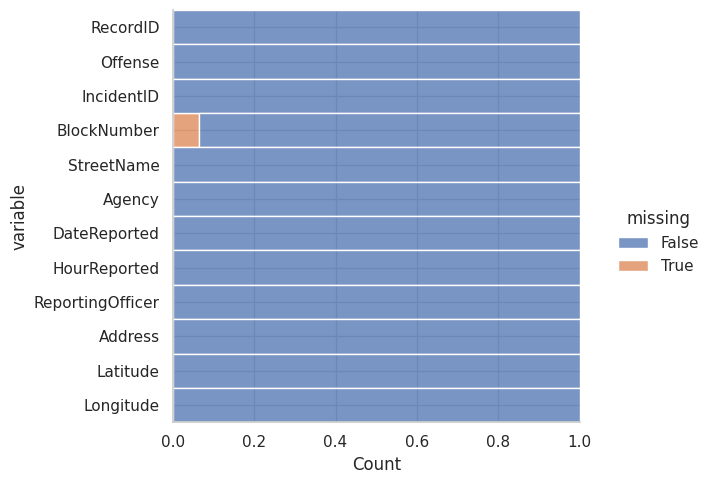

In [88]:
#Check NA's 
sns.displot(
    data=crime_data.isna().melt(value_name='missing'),
    y='variable',
    hue='missing',
    multiple='fill',
    aspect=1.25
)

# Exploratory Data Analysis

> - We believe the type of crime committed `Offense` as well as the location the crime was committed in `longitude, latitude` will be our most important features here
> - Potentially the time of day as well, `Hour Reported`

In [145]:
crime_data.describe()

,RecordID,IncidentID,BlockNumber,HourReported,Latitude,Longitude,Cluster_5,Cluster_10,Cluster_15,Cluster_20,Cluster_30,Cluster_40
count,24632.000000,2.463200e+04,23060.000000,24632.000000,24632.000000,24632.000000,24632.000000,24632.000000,24632.000000,24632.000000,24632.000000,24632.000000
mean,12316.500000,2.020000e+11,880.858630,1348.148019,38.033397,-78.487899,1.486197,4.230188,6.195396,8.001786,14.087122,3.766848
std,7110.790251,0.000000e+00,625.591216,589.366635,0.013390,0.016735,1.494734,2.868781,3.975415,6.098311,8.963255,2.567793
min,1.000000,2.020000e+11,100.000000,0.000000,37.954837,-78.702248,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,6158.750000,2.020000e+11,400.000000,959.000000,38.024431,-78.498368,0.000000,1.000000,3.000000,2.000000,7.000000,1.000000
50%,12316.500000,2.020000e+11,800.000000,1406.000000,38.031642,-78.489878,1.000000,4.000000,6.000000,8.000000,12.000000,5.000000
75%,18474.250000,2.020000e+11,1300.000000,1809.000000,38.038588,-78.478459,3.000000,7.000000,9.000000,13.000000,22.000000,6.000000
max,24632.000000,2.020000e+11,7100.000000,2359.000000,38.938091,-77.044933,4.000000,9.000000,14.000000,19.000000,29.000000,8.000000


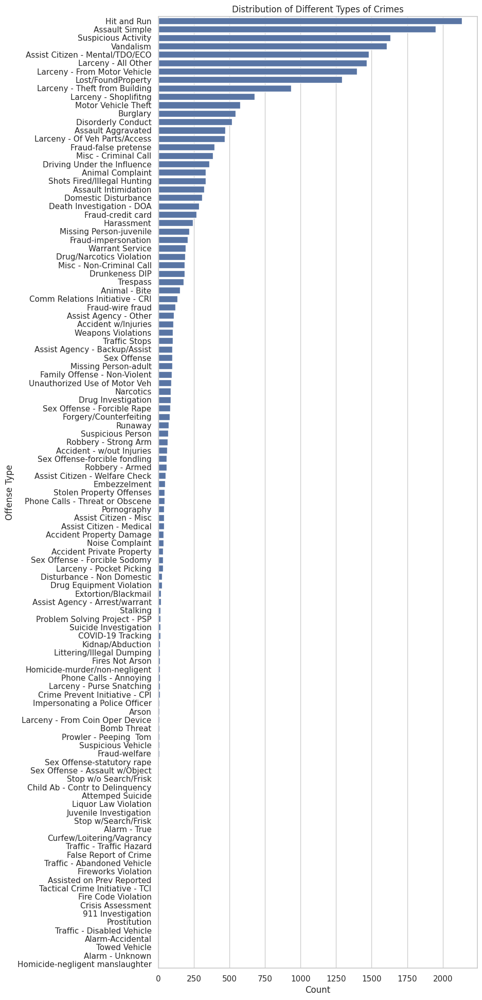

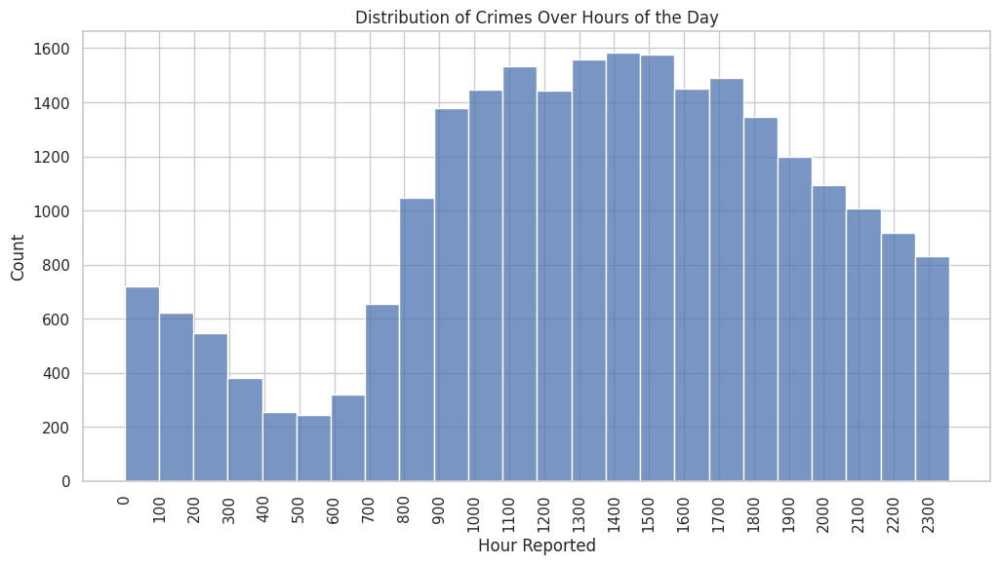

In [89]:
# 1. Distribution of different types of crimes
plt.figure(figsize=(8, 24))
sns.countplot(y='Offense', data=crime_data, order=crime_data['Offense'].value_counts().index)
plt.title('Distribution of Different Types of Crimes')
plt.xlabel('Count')
plt.ylabel('Offense Type')
plt.show()

# 2. Distribution of crimes over hours of the day
plt.figure(figsize=(12, 6))
sns.histplot(crime_data['HourReported'], bins=24, kde=False)
plt.title('Distribution of Crimes Over Hours of the Day')
plt.xlabel('Hour Reported')
plt.ylabel('Count')
plt.xticks(range(0, 2400, 100), rotation=90)

plt.grid(True)
plt.show()

# Time to Engineer Some Simple Features:

In [90]:
crime_data['PersonalCrime'] = crime_data['Offense'].str.contains('|'.join(['Assault', 'Domestic', 'Sex Offense', 'Stalking', 'Kidnap', 'Homicide', 'Child Ab'])).astype('category')
crime_data['PropertyCrime'] = crime_data['Offense'].str.contains('|'.join(['Hit and Run', 'Vandalism', 'Robbery', 'Larceny', 'Theft', 'Burglary', 'Stolen', 'Arson'])).astype('category')

#if a crime happens between ~10 PM - ~ 6 PM it is considered a night crime which is probably more severe
crime_data['NightCrime'] = crime_data['HourReported'].apply(lambda time: time < 700 or time > 2100)

# Time to Clean the Data and Build a One Stop Shop Pipeline:

In [91]:
# Convert all objects -> categorys
cat_columns = crime_data.select_dtypes(include='object').columns
crime_data[cat_columns] = crime_data[cat_columns].astype('category')

In [94]:
#Unnecessary for our purposes:
crime_data_dropped = crime_data.drop(['RecordID', 'IncidentID', 'Agency', 'ReportingOfficer', 'BlockNumber', 'StreetName', 'Address', 'DateReported'], axis=1)
crime_data_dropped.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24632 entries, 0 to 24631
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   Offense        24632 non-null  category
 1   HourReported   24632 non-null  int64   
 2   Latitude       24632 non-null  float64 
 3   Longitude      24632 non-null  float64 
 4   PersonalCrime  24632 non-null  category
 5   PropertyCrime  24632 non-null  category
 6   NightCrime     24632 non-null  bool    
dtypes: bool(1), category(3), float64(2), int64(1)
memory usage: 678.8 KB


# Pipeline:

In [97]:
# Identifying numerical and categorical attributes
num_attribs = ['Latitude', 'Longitude', 'HourReported']  # Assuming these as relevant numerical attributes for clustering
cat_attribs = ['Offense', 'PersonalCrime', 'PropertyCrime', 'NightCrime']  # Assuming 'Offense' is a relevant categorical attribute

# Creating numerical pipeline
num_pipeline = Pipeline([
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])

# Creating categorical pipeline
cat_pipeline = Pipeline([
    #('imputer', SimpleImputer(strategy='most_frequent')),
    ('encoder', OneHotEncoder(handle_unknown='ignore'))
])

# Full pipeline
full_pipeline_crime = ColumnTransformer([
    ('num', num_pipeline, num_attribs),
    ('cat', cat_pipeline, cat_attribs)
])

# Applying the pipeline to the crime dataset
crime_data_transformed = full_pipeline_crime.fit_transform(crime_data_dropped)
crime_data_transformed.shape

(24632, 122)

# Methods:

> - We plan to use KMeans to generate thses clusters, though there are other techniques like DBSCAN, we think this simple, more readily usable model should be plenty for us
> - Now to choose our features and select a reasonable value for k

In [140]:
# Apply k-means clustering with k = 5
kmeans = KMeans(n_clusters=5, init='k-means++', random_state=42)
clusters = kmeans.fit_predict(crime_data_transformed)

def plot_clusters_on_map(data, clusters, lat_col='Latitude', lon_col='Longitude', center=[38, -78.5], zoom=13):
    # Generate a color palette with a distinct color for each cluster
    num_clusters = len(set(clusters))
    colors = plt.cm.get_cmap('viridis', num_clusters)

    # Create a Folium map
    m = folium.Map(location=center, zoom_start=zoom)

    # Add cluster points to the map
    for idx, row in data.iterrows():
        # Define the cluster color
        color = matplot_colors.to_hex(colors(clusters[idx]))

        # Add a circle marker for each point
        folium.CircleMarker(
            location=[row[lat_col], row[lon_col]],
            radius=3,
            color=color,
            fill=True
        ).add_to(m)

    m.options['zoomControl'] = True
    m.options['dragging'] = False
    m.options['doubleClickZoom'] = False
    m.options['scrollWheelZoom'] = False
    m.options['touchZoom'] = False
    
    return m


#data visualization: display the map
#chosen metrics: inertia and silhouette score
m = plot_clusters_on_map(crime_data, clusters)
clear_output()
display(m)
print("inertia value:", kmeans.inertia_)
print("silhouette value: ", silhouette_score(crime_data_transformed, clusters))

inertia value: 74111.0552321907
silhouette value:  0.15554930433763847


# Evaluation of Model:

> - Looks like between 10-20 clusters is our idealm after that we're being unreasonable.
> - Also, the CPD needs to have enough officers for the clusters to really make any sense past ~10

Testing k values:   0%|                                                                          | 0/100 [00:00<?, ?k/s]/home/wloving77/Githubs/Fall2023Classes/foundations_of_machine_learning/env/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
Testing k values: 100%|████████████████████████████████████████████████████████████████| 100/100 [03:49<00:00,  2.30s/k]


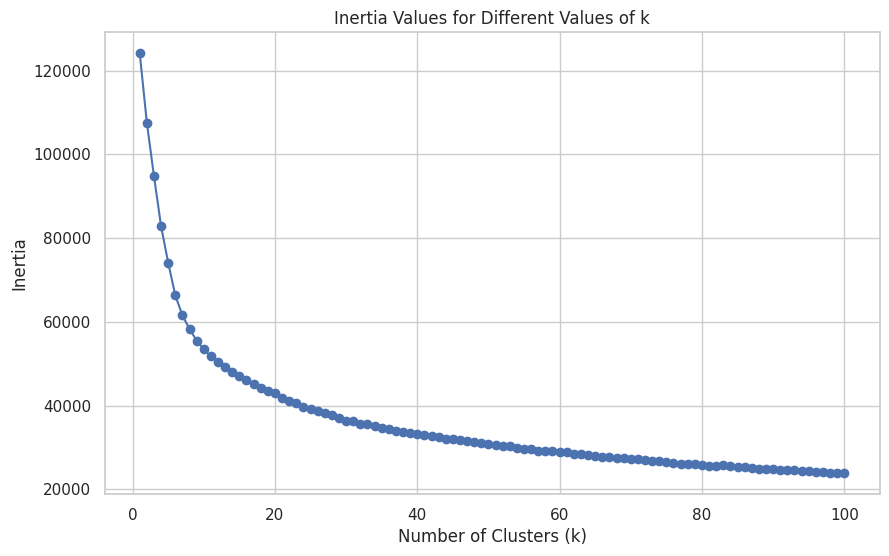

In [122]:
# Initialize an empty list to store inertia values
inertia_values = []

# Test different values of k from 1 to 100
for k in tqdm(range(1, 101), desc="Testing k values", unit="k"):
    kmeans = KMeans(n_clusters=k, init='k-means++', random_state=42)
    clusters = kmeans.fit_predict(crime_data_transformed)
    inertia_values.append(kmeans.inertia_)

# Plotting the inertia values
plt.figure(figsize=(10, 6))
plt.plot(range(1, 101), inertia_values, marker='o')
plt.title('Inertia Values for Different Values of k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.grid(True)
plt.show()

# Lets Try Clustering Exclusively on Location: 

> This is the real goal, to give the CPD a valid grouping of locations to assign officers to.

In [144]:
features = ['Latitude', 'Longitude']
crime_locations = crime_data[features]

# Coordinates for Charlottesville
charlottesville_coords = [38.0293, -78.4767]
zoom_level = 13

# Test different values of k
k_value = 9

# Apply k-means clustering
kmeans = KMeans(n_clusters=k_value, init='k-means++', random_state=42)
clusters = kmeans.fit_predict(crime_locations)

# Adding cluster information to the original DataFrame
crime_data[f'Cluster_{k}'] = clusters
# Visualizing the clusters on a map using Folium
m = plot_clusters_on_map(crime_data, clusters)
clear_output()
display(m)

# Print inertia value
inertia_value = kmeans.inertia_
print(f"Inertia value for k={k_value}: {inertia_value}")
print("Silhouette value: ", silhouette_score(crime_locations, clusters))

Inertia value for k=9: 1.1102375210956796
Silhouette value:  0.44598710676191766


# Final Evaluation:
> - We were able to get solid inertia scores, solid Silhouette scores, and very reasonable looking clusterings.
> - Limitations: The best clusterings incorporated the fewest features at just `Longitude` and `Latitude`, so moving forward we would like to bring more information intot he cluster choices like `Population` if only we could find the data 

# Conclusions: 
> - Our Clusters are solid and with the very low inertia and reasonable silhouette values we can say that the clusters are good.
> - They are usable and reasonably sized for a police force the size of the CPD with ~100 officers in total (Not always patrolling)
> - The clusters can be regenerated at will to get different groupings based on the number of available officers at a given time.

# Going Forward (Limitations):

> - If this project were to continue on and we had significantly more resources at our disposal, we would likely begin by implementing/including the population of the districts as a factor as well.
> - This would make the clusterings significantly more fair as a given officer could expect a reasonable population to be in every region they are assigned to
> - Essentially, we wish we had population data that we could join onto the longitude and latitudes of the crimes, but for now, this will do.
